# 1. Predicting Turning Points in Share Prices

The work in this notebook is based on [this preprint](https://arxiv.org/abs/1209.0127). The general idea is to use machine learning to predict turning points (i.e. pivots; local extrema) in share prices. To do this we first have to detect these turning points, before generating a Turning Point Oscillator - this is what we use as our prediction target. This oscillator normalises all prices to their nearest trough (0) and peak (1). We then use Support Vector Regression to predict oscillator values, and if our prediction crosses certain thresholds, we execute a buy / sell order. 

## Resources

[Post explaining how to find timeseries maxima and minima in pandas in python](https://eddwardo.github.io/posts/2019-06-05-finding-local-extreams-in-pandas-time-series/)

[Page describing different ways of getting historical market data in python](https://blog.quantinsti.com/historical-market-data-python-api/
)

[Preprint describing the implementation of a turning point predictor built using SVR to predict turning points in stock prices](https://arxiv.org/abs/1209.0127)

## Import Libraries

In [1]:
# Used to retrieve historical market data for the DJIA that we use to show our approach matches the preprint
import quandl
import json

# For data manipulation
import pandas as pd
import numpy as np

import pandas_market_calendars as mcal

# Import our custom functions for detecting turning points (local extrema), turning this into a
# turning point oscillator, creating model features from this, and evaluating a SVR model built on these
from extremaFuncs import getLabelledExtrema, getExtremaToDrop, optimiseTpOscillator, normaliseTpOsc
from modelFuncs import generateNormalizedLookback, generateFFTLookback, TpSVRGridSearch, plotModelOutputs, getFeaturesAndTargets, TpSVROptParams
from tradingFuncs import getStratResults, getDataArgs, getStratData, evaluateSVRStrat, tradeStrategy

# For progress bar
from tqdm.auto import tqdm

import os
import warnings

# For datetime manipulation
from dateutil import parser

# For implementing a SVR model
from sklearn import svm
from sklearn.model_selection import train_test_split
from itertools import chain

# For plotting
import matplotlib.pyplot as plt
import seaborn as sns

import cufflinks as cf
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.graph_objects as go
from plotly.subplots import make_subplots

#init_notebook_mode(connected = True)
init_notebook_mode()
cf.go_offline()
%matplotlib inline

/opt/anaconda3/lib/python3.8/site-packages/scipy/__init__.py:138: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.0)
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion} is required for this version of "


## Labelling Turning Points

### Reading in Historical Data

To identify turning points in our timeseries, we must first load in historical share price data. Here we are using the quandl library to load in historical Dow Jones Industrial Average daily prices (open, high, low, and close) from September 1st 2008 until July 1st 2009


In [2]:
with open('credentials.json', 'r') as j:
    api_key = json.loads(j.read())
        
    # Load in DJIA data from October 2008 to May 2009
    data = quandl.get("BCB/UDJIAD1", start_date="2008-09-01", end_date="2009-09-01", api_key=api_key['quandl_key']).reset_index()
    data.rename(columns = {'Value': 'Close'}, inplace = True)

<AxesSubplot:ylabel='Close'>

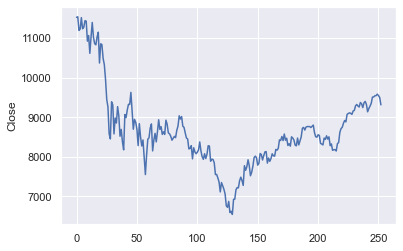

In [3]:
# Plot the closing price for each day in this dataset
# This timeframe matches that plotted in Figure 3 of the preprint
sns.set_theme()
sns.lineplot(x = data.index, y = 'Close', data = data)

### Identifying and Describing Turning Points

Turning points (i.e. local extrema) can be detected using the argrelextrema() function in the scipy.signal library. 

Iterating through different values of the 'order' argument in this function allows you to identify the magnitude of these local extrema (i.e. their degree). A turning point's degree describes how many timepoints on either side of it are below / above its value for a peak / trough. 
- e.g. a peak of degree 10 is a local maxima where there are 10 timepoints either side of it that are less than its value. This means at a timepoint that is either 11 timepoints ahead, behind, or both, from this point, the timeseries has a value higher than this peak.

Another way of describing turning points is through their impact. A peak's impact is calculated by looking at all the values that follow the peak and are below its value (i.e. all subsequent timepoints before we reach a value that is >= the peak's value). We then take the difference between the peak and the lowest value in this following sequence and calculate what percent difference this represents relative to the peak value.
- e.g. imagine a peak of value 100. For its impact to be 10%, the lowest point the timeseries of points that immediately follow the peak (prior to the first time at which our value matches or exceeds our peak) would have to have a value of 90, so that the difference (10) represents a 10% change in the peak value of 100.

For more detailed descriptions, please see the [preprint](https://arxiv.org/abs/1209.0127)

The function getLabelledExtrema() takes a numpy array and returns a pandas dataframe containing the raw values, as well as labels indicating if a value is a local extrema (minima or maxima), and if so what it's degree and impact are.


In [4]:
# For each local extrema in the 'Close' prices, get its type (maxima or minima),
# its degree, and its impact
extremaDf = getLabelledExtrema(np.array(data['Close']))

Retrieving extrema values in degrees
Retrieving extrema values in impact


In [5]:
extremaDf.set_index(data.index, inplace=True)

# Ensure this table's index has a name to help with reassigning the right
# index value to child tables later
extremaDf.index.names = ['Datetime']
extremaDf.head()

,value,degree,impact,label
Datetime,,,,
0,11516.92,1.0,0.001386,minima
1,11532.88,252.0,0.432314,maxima
2,11188.23,6.0,0.028826,minima
3,11220.96,0.0,0.000000,None
4,11510.74,2.0,0.431222,maxima


### Visualising Turning Points with Different Properties

Here we've plotted all turning points that have an impact of >=10%, or have a degree >= 10.

In [6]:
impactFiltered = extremaDf[extremaDf['impact'] >= 0.1]
degreeFiltered = extremaDf[extremaDf['degree'] >= 10]

In [7]:
# Plot the detected extrema
marker_size_val = 13
marker_opacity_val = 0.7

fig = go.Figure()
fig.add_trace(
    go.Scatter(
        x=extremaDf.index, 
        y=extremaDf['value'],
        mode='lines',
        name='Closing Value'
    )
)

fig.add_trace(
    go.Scatter(
        x=impactFiltered[impactFiltered['label'] == 'minima'].index, 
        y=impactFiltered[impactFiltered['label'] == 'minima']['value'],
        mode='markers', 
        name='Minima of Impact >= 10%',
        marker_symbol = 'triangle-down',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.add_trace(
    go.Scatter(
        x=impactFiltered[impactFiltered['label'] == 'maxima'].index, 
        y=impactFiltered[impactFiltered['label'] == 'maxima']['value'],
        mode='markers', 
        name='Maxima of Impact >= 10%',
        marker_symbol = 'triangle-up',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.add_trace(
    go.Scatter(
        x=degreeFiltered[degreeFiltered['label'] == 'minima'].index, 
        y=degreeFiltered[degreeFiltered['label'] == 'minima']['value'],
        mode='markers', 
        name='Minima of Degree >= 10',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.add_trace(
    go.Scatter(
        x=degreeFiltered[degreeFiltered['label'] == 'maxima'].index, 
        y=degreeFiltered[degreeFiltered['label'] == 'maxima']['value'],
        mode='markers', 
        name='Maxima of Degree >= 10',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.update_layout(
    title="Turning Points in the DJIA 01/09/08 - 01/09/09",
    xaxis_title="Date",
    yaxis_title="Closing Value",
    legend_title="Legend"
)

fig.show("notebook")

## Constructing a Turning Point Oscillator

### Selecting the Turning Points to Predict

In order to construct our prediction target (the Turning Point Oscillator) we first have to select the type of turning points (e.g. degree >= 5, impact >= 3%) we would like to predict. This will obviously have an impact on the accuracy of our predictions, and should be fine tuned in order to generate the optimal trading strategy. For demonstration purposes, we will limit ourselves to turning points of impact >= 2%.

#### Turning Points of Impact >= 2%


In [8]:
impactFiltered = extremaDf[extremaDf['impact'] >= 0.02]

In [9]:
# Plot the detected extrema based on an impact of >= 1%
# Plot the detected extrema
marker_size_val = 13
marker_opacity_val = 0.7

fig = go.Figure()
fig.add_trace(
    go.Scatter(
        x=extremaDf.index, 
        y=extremaDf['value'],
        mode='lines',
        name='Closing Value'
    )
)

fig.add_trace(
    go.Scatter(
        x=impactFiltered[impactFiltered['label'] == 'minima'].index, 
        y=impactFiltered[impactFiltered['label'] == 'minima']['value'],
        mode='markers', 
        name='Minima of Impact >= 2%',
        marker_symbol = 'triangle-down',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.add_trace(
    go.Scatter(
        x=impactFiltered[impactFiltered['label'] == 'maxima'].index, 
        y=impactFiltered[impactFiltered['label'] == 'maxima']['value'],
        mode='markers', 
        name='Maxima of Impact >= 2%',
        marker_symbol = 'triangle-up',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.update_layout(
    title="Turning Points with Impact >=2% in the DJIA 01/09/08 - 01/09/09",
    xaxis_title="Date",
    yaxis_title="Closing Value",
    legend_title="Legend"
)

fig.show("notebook")

### Generating an Alternating Sequence of Turning Points

The first requirement of our turning point oscillator to fulfil is that it represents an alternating sequence of peaks and troughs - in this way we can use it to issue alternating buy / sell orders. To do this, we look at our chosen turning points and apply some logic.


For a given turning point:

1. Remove any turning points of the same kind that occur in an uninterrupted sequence i.e. if we have peaks at 1,3,5, and 8, and a trough at 7, we will remove the turning points at 3 and 5.
2. Refine our chosen alternating sequence of turning points so that any given peak represents the highest value between two troughs, and vice versa (e.g. if the peak at 3 is the largest, we now have a sequence that is 3, 7)

The function getExtremaToDrop() takes a filtered output of getLabelledExtrema that only contains the turning points we want to predict, and returns a list containing the indices of the turning points to drop that don't satisfy requirement 1.

#### Example findAdjacentExtremaMult() Input (Turning Points of Impact >= 2%)


In [10]:
impactFiltered.head()

,value,degree,impact,label
Datetime,,,,
1,11532.88,252.0,0.432314,maxima
2,11188.23,6.0,0.028826,minima
4,11510.74,2.0,0.431222,maxima
7,11433.71,2.0,0.427391,maxima
10,11059.02,1.0,0.040633,maxima


#### Alternating Turning Points Sequence (Step 1)

In [11]:
# Reset the index in our new filtered DF
filteredDf = impactFiltered.reset_index()

# Get the indices to drop from this filtered DF
indicesToRemove = getExtremaToDrop(filteredDf)

# Drop the indices that it tells us to drop from the tpOsc object
tpOsc = filteredDf.drop(indicesToRemove, axis=0)
tpOsc.set_index(tpOsc[impactFiltered.index.name], inplace= True)
    
# Get the rows that we removed
removedRows = impactFiltered.loc[filteredDf.loc[indicesToRemove][impactFiltered.index.name]]

In [12]:
tpOsc.head()

,Datetime,value,degree,impact,label
Datetime,,,,,
1,1,11532.88,252.0,0.432314,maxima
2,2,11188.23,6.0,0.028826,minima
4,4,11510.74,2.0,0.431222,maxima
11,11,10609.66,7.0,0.073403,minima
13,13,11388.44,4.0,0.425114,maxima


In [13]:
# Plot the detected extrema based on an impact of >= 1%
# Plot the detected extrema
marker_size_val = 13
marker_opacity_val = 0.7

fig = go.Figure()
fig.add_trace(
    go.Scatter(
        x=extremaDf.index, 
        y=extremaDf['value'],
        mode='lines',
        name='Closing Value'
    )
)

fig.add_trace(
    go.Scatter(
        x=tpOsc[tpOsc['label'] == 'minima'].index, 
        y=tpOsc[tpOsc['label'] == 'minima']['value'],
        mode='markers', 
        name='Minima of Impact >= 2%',
        marker_symbol = 'triangle-down',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.add_trace(
    go.Scatter(
        x=tpOsc[tpOsc['label'] == 'maxima'].index, 
        y=tpOsc[tpOsc['label'] == 'maxima']['value'],
        mode='markers', 
        name='Maxima of Impact >= 2%',
        marker_symbol = 'triangle-up',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.add_trace(
    go.Scatter(
        x=removedRows[removedRows['label'] == 'minima'].index, 
        y=removedRows[removedRows['label'] == 'minima']['value'],
        mode='markers', 
        name='Removed Minima of Impact >= 2%',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.add_trace(
    go.Scatter(
        x=removedRows[removedRows['label'] == 'maxima'].index, 
        y=removedRows[removedRows['label'] == 'maxima']['value'],
        mode='markers', 
        name='Removed Maxima of Impact >= 2%',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.update_layout(
    title="Turning Points with Impact >=2% in the DJIA 01/09/08 - 01/09/09 (Alternating Sequence)",
    xaxis_title="Date",
    yaxis_title="Closing Value",
    legend_title="Legend"
)

fig.show("notebook")

#### Refined Alternating Turning Point Sequence

Here our optimiseTpOscillator() function takes our raw timeseries values, and our unrefined Turning Point alternating sequence, and returns a version of this unrefined sequence that satisfies both requirement 1. and 2. (i.e. our turning points are alternating, and peaks represents the highest values between troughs and vice versa)

In [14]:
newTpOscDirty = optimiseTpOscillator(
    extremaDf['value'], 
    tpOsc[['value', 'label']]
)

secondCleanToDrop =  getExtremaToDrop(newTpOscDirty)

# Drop the indices that it tells us to drop from the tpOsc object
newTpOsc = newTpOscDirty.drop(secondCleanToDrop, axis=0)

In [15]:
# Get a list of the indices where we changed the value of our extrema
changedLocations = [x for x in tpOsc.index if tpOsc.loc[x, 'value'] != newTpOsc.loc[x, 'value']]

In [16]:
# Plot the detected extrema based on an impact of >= 2%
marker_size_val = 13
marker_opacity_val = 0.7

fig = go.Figure()
fig.add_trace(
    go.Scatter(
        x=extremaDf.index, 
        y=extremaDf['value'],
        mode='lines',
        name='Closing Value'
    )
)

fig.add_trace(
    go.Scatter(
        x=newTpOsc[newTpOsc['label'] == 'minima'].index, 
        y=newTpOsc[newTpOsc['label'] == 'minima']['value'],
        mode='markers', 
        name='Optimised Minima of Impact >= 2%',
        marker_symbol = 'triangle-down',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.add_trace(
    go.Scatter(
        x=newTpOsc[newTpOsc['label'] == 'maxima'].index, 
        y=newTpOsc[newTpOsc['label'] == 'maxima']['value'],
        mode='markers', 
        name='Optimised Maxima of Impact >= 2%',
        marker_symbol = 'triangle-up',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.add_trace(
    go.Scatter(
        x = tpOsc[(tpOsc.index.isin([changedLocations])) & (tpOsc['label'] == 'minima')].index,
        y = tpOsc[(tpOsc.index.isin([changedLocations])) & (tpOsc['label'] == 'minima')]['value'],
        mode='markers', 
        name='Updated Minima of Impact >= 2%',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.add_trace(
    go.Scatter(
        x = tpOsc[(tpOsc.index.isin([changedLocations])) & (tpOsc['label'] == 'maxima')].index,
        y = tpOsc[(tpOsc.index.isin([changedLocations])) & (tpOsc['label'] == 'maxima')]['value'],
        mode='markers', 
        name='Updated Maxima of Impact >= 2%',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.update_layout(
    title="Turning Points with Impact >=2% in the DJIA 01/09/08 - 01/09/09 (Fully Cleaned)",
    xaxis_title="Date",
    yaxis_title="Closing Value",
    legend_title="Legend"
)

fig.show("notebook")

### Normalising Values to Their Nearest Peak and Trough

Once we have a sequence of alternating turning points, we next normalise values in our share price timeseries to their nearest peak (1) and trough (0). The result of this is the final Turning Point Oscillator that we use as a prediction target. This is done here with the normaliseTpOsc() function.


In [17]:
TpOscFull = normaliseTpOsc(extremaDf, newTpOsc)
TpOscFull.head(10)

,value,degree,impact,label,normalised
Datetime,,,,,
0,11516.92,1.0,0.001386,None,None
1,11532.88,252.0,0.432314,maxima,1.0
2,11188.23,6.0,0.028826,minima,0.0
3,11220.96,0.0,0.000000,None,0.101485
4,11510.74,2.0,0.431222,maxima,1.0
5,11230.73,1.0,0.018074,None,0.689251
6,11268.92,0.0,0.000000,None,0.731633
7,11433.71,2.0,0.427391,None,0.914514
8,11421.99,0.0,0.000000,None,0.901507


In [18]:
# Plot the detected extrema based on an impact of >= 2%
marker_size_val = 13
marker_opacity_val = 0.7

fig = go.Figure()
fig.add_trace(
    go.Scatter(
        x=TpOscFull.index,
        y=TpOscFull['normalised'],
        mode='lines',
        name='Normalised Closing Value'
    )
)

fig.add_trace(
    go.Scatter(
        x=TpOscFull[(TpOscFull.label == 'minima')].index,
        y=TpOscFull[(TpOscFull.label == 'minima')]['normalised'],
        mode='markers', 
        name='Optimised Minima of Impact >= 2%',
        marker_symbol = 'triangle-down',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.add_trace(
    go.Scatter(
        x=TpOscFull[(TpOscFull.label == 'maxima')].index,
        y=TpOscFull[(TpOscFull.label == 'maxima')]['normalised'],
        mode='markers', 
        name='Optimised Maxima of Impact >= 2%',
        marker_symbol = 'triangle-up',
        marker_size = marker_size_val,
        marker_opacity = marker_opacity_val

    )
)

fig.update_layout(
    title="Turning Points with Impact >=2% in the DJIA 01/09/08 - 01/09/09 (Normalised to Local Extrema)",
    xaxis_title="Date",
    yaxis_title="Normalised Closing Value",
    legend_title="Legend"
)

fig.show("notebook")

In the plot above you can see how at each timepoint the value is normalised between its nearest peak and trough. Note that the sequence starts only at the first turning point plotted on our raw sequence.

## Training a Model to Predict the Turning Point Oscillator

### Generating Features

Now that we have our target, we need our features. Here for a target T, we take the X raw values that precede T and normalise these X values between 0 and 1 using the Normalizer from sklearn. We also take the amplitude and phase of a discrete fourier transform of these X values. Together the normalised values, amplitude, and phases, form our features for predicting target T. Note that we also normalise our fourier amplitudes and phases between 0 and 1.

Key in this feature generation is the size of the lookback window (i.e. X) we use. This is a parameter that should be optimised.

First we filter our turning point oscillator for values bounded by turning points (i.e. timepoints after our first, and before our last). We then run our feature generation functions on this and combine the outputs.

In [19]:
TpOscFull

,value,degree,impact,label,normalised
Datetime,,,,,
0,11516.92,1.0,0.001386,None,None
1,11532.88,252.0,0.432314,maxima,1.0
2,11188.23,6.0,0.028826,minima,0.0
3,11220.96,0.0,0.000000,None,0.101485
4,11510.74,2.0,0.431222,maxima,1.0
...,...,...,...,...,...
248,9543.52,0.0,0.000000,None,0.916661
249,9580.63,203.0,0.028185,maxima,1.0
250,9544.20,0.0,0.000000,None,None


In [20]:
# Split our turning point oscillator into features and targets - note we are generating features using the 
# actual value of the price and using these to predict the normalised value
featuresIn = TpOscFull.reset_index()['value']

# Set a lookback window size of 8 and generate features using that lookback window
lookbackWindow = 8
featuresRaw = generateNormalizedLookback(np.array(featuresIn), lookbackWindow)
amps, phases = generateFFTLookback(np.array(featuresIn), lookbackWindow)

TpOscFull.index = list(TpOscFull.index)
indexOfFeaturesRaw = TpOscFull.iloc[lookbackWindow:].index

# Here what we have is a 2D np array where for each element, the first 8 are the normalised raw prices,
# the next 8 are the normalised FFT amplitudes of those prices, and the final 8 are the normalised FFT
# phases of those prices. Note here that with a larger lookback window, the size of the array gets bigger
# combinedFeaturesRaw = np.concatenate((featuresRaw,amps,phases), axis=1)
combinedFeaturesRaw = np.concatenate((featuresRaw,phases), axis=1)

# Get our targets
# Filter out turning point oscillator for values that are not null, i.e., values after our first turning point
# and before our last
dataToUse = TpOscFull[~TpOscFull['normalised'].isnull()]
targetsRaw = np.array(dataToUse['normalised'])
indexOfTargetsRaw = dataToUse.index

In [21]:
indexOfTargets = indexOfTargetsRaw[indexOfTargetsRaw > indexOfFeaturesRaw[0]]
indexOfFeatures = indexOfFeaturesRaw[indexOfFeaturesRaw < indexOfTargetsRaw[-1]]

In [22]:
target = targetsRaw[indexOfTargetsRaw > indexOfFeaturesRaw[0]]
features = combinedFeaturesRaw[indexOfFeaturesRaw < indexOfTargetsRaw[-1]]

Here with combinedFeatures what we have is a 2D np array where for each element, the first 8 are the normalised raw prices, the next 8 are the normalised FFT amplitudes of those prices, and the final 8 are the normalised FFT phases of those prices. Note here that with a larger lookback window, the size of the array gets bigger.

The first element of this 2D array serves as the features to predict the first element of target.

In [23]:
# The first element of combinedFeatures serves as the features to predict the first element of target e.g.
print('Features for first element')
print(features[0])
print('')
print('Target for first element')
print(target[0])
print('')
print('Index for the first target')
print(indexOfTargets[0])
print('')
print('Index for the first features')
print(indexOfFeatures[0])

Features for first element
[ 0.35831898  0.35881553  0.34809265  0.34911095  0.3581267   0.34941492
  0.3506031   0.35573012 -0.          0.01205531 -0.04823219 -0.70535688
 -0.          0.70535688  0.04823219 -0.01205531]

Target for first element
0.34164558085852575

Index for the first target
9

Index for the first features
8


### Creating a Train / Validate / Test Split

Now that we have all the features for our entire dataset, we must divide our features and targets into a training set that we will use to train the model. Additionally, we need to set aside data that we will use to 'tune' i.e. optimise the thresholds we set for defining when to buy / sell. Finally, we have a test dataset that we apply our trained model to, using our tuned thresholds, to evaluate the performance of our model.

The manuscript we are attempting to replicate divides data into train, validate, and test sets without shuffling i.e. they are uninterrupted sequences over time. To replicate this, we can use train_test_split() from sklearn with shuffle = False. To show that this approach works, we can use the function on our date index.

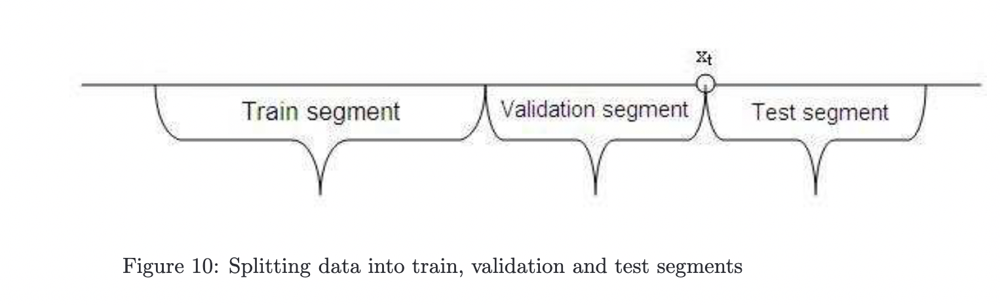

In [24]:
# Split into test and train
X_train, X_test, y_train, y_test = train_test_split(indexOfFeatures, target, test_size=0.2, random_state=1, shuffle = False)

# Split train into train and validate
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.5, random_state=1, shuffle = False)

In [25]:
print('Training data index bounds:')
print(min(X_train), '---', max(X_train))
print('')
print('Validation data index bounds:')
print(min(X_val), '---', max(X_val))
print('')
print('Testing data index bounds:')
print(min(X_test), '---', max(X_test))

Training data index bounds:
8 --- 103

Validation data index bounds:
104 --- 199

Testing data index bounds:
200 --- 248


Now we split our features and target into train, validate, and test datasets

In [26]:
# Split into test and train
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=1, shuffle = False)

# Split train into train and validate
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.5, random_state=1, shuffle = False)

### Model Hyperparameter Optimisation

The strategy in the manuscript was to use an epsilon support vector regression (SVR) model, with a radial basis function kernel, to use our features to predict our target. However, there's more to it - since we are intending to use this model to predict turning points in our share prices, we need to have thresholds at which we consider a value of the prediction to be a peak or a trough.

These thresholds are defined as Thigh and Tlow, where a prediction above Thigh indicates a peak, and a prediction below Tlow indicates a trough.

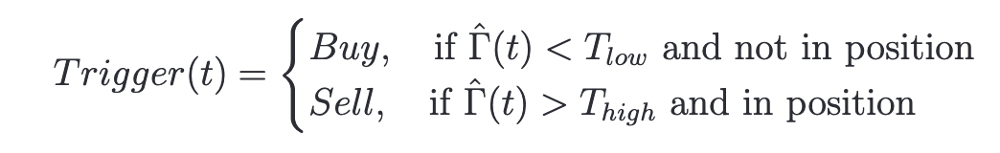

These thresholds can be treated as additional hyperparameters for tuning, where the other hyperparameters for an epsilon SVR are C, epsilon, and gamma. The proposed method for training our SVR model is to score it using a Turning Point Root Mean Squared Error function (TpRMSE). The TpRMSE is defined as:

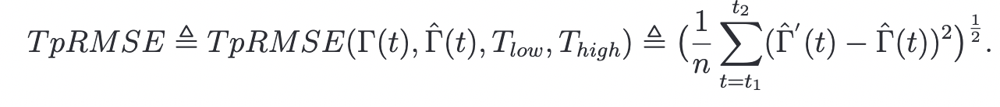

Where T^ is our prediction, and T' is a value calculated as such:
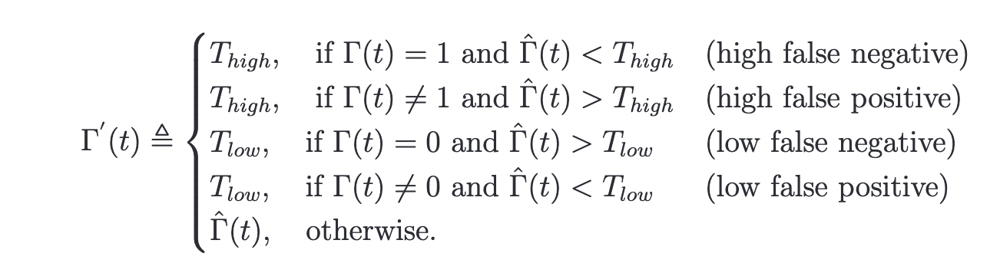

The process is thereby as follows:
- Fit an SVR model with a set of hyperparameters (C, epsilon, gamma) on training data
- Use this SVR model to predict values for validation data
- Compute the T' value from this prediction and relative to the specified values of Thigh and Tlow
- Compute the TpRMSE from this T' value

To this end, the manuscript proposes a strategy where:

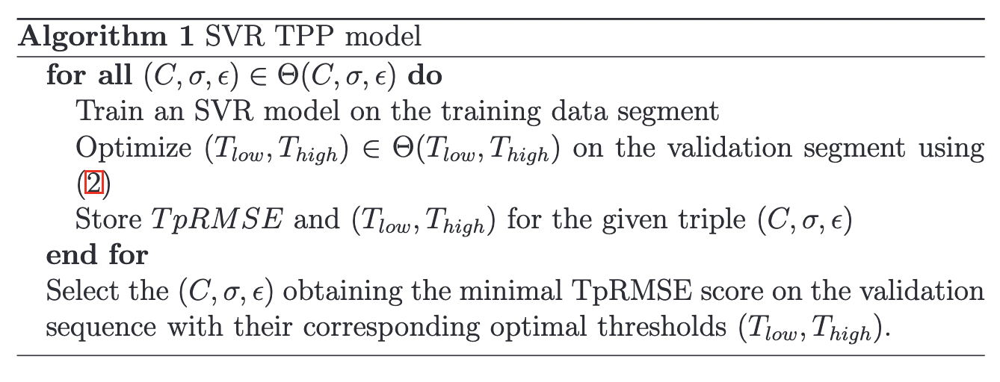

However, the scikit learn implementation of the SVR only specifies C and epsilon as free parameters. You can choose to modify gamma, but for our purposes we'll only tweak C and epsilon.

#### Calculating T'

To begin with, we need to demonstrate that we can properly calculate T' for a set of predictions and targets. Here we plot some predictions with arbitrary values for Thigh and Tlow of 0.6 and 0.4 respectively and also plot the T' value, as well as the mean squared error between our prediction and T'.

In [27]:
# Specify Thigh and Tlow
Thigh = 0.8
Tlow = 0.2
plot = plotModelOutputs(
    X_train = X_train
    , y_train = y_train
    , X_test = X_val
    , y_test = y_val
    , Thigh = Thigh
    , Tlow = Tlow
    , paramDict = {'C': 32
       , 'epsilon': 0.05
       , 'gamma': 0.0625
       , 'kernel': 'rbf'
       , 'cache_size': 1000
       }
    , modelString = 'svr'
)

plot.show("notebook")

#### Computing TpRMSE for Different Hyperparameters

Now we must select the hyperparameters for our model that provides the lowest value of TpRMSE. To do this, we are going to perform an exhaustive grid search. First we create instances of an epsilon SVR model, one for each combination of C, epsilon, and gamma values we want to try. Then for each of these, we iterate through all possible values of Thigh and Tlow and return the values of these the provides the smallest TpRMSE. We then select the values of C, epsilon, and gamma associated with the smallest TpRMSE.

In this example our search space for C, epsilon, and gamma is:  
C: [0.1, 1, 10, 100]  
Epsilon: [0.01, 0.05, 0.1]  
Gamma: [0.1, 1, 10, 100]  (note here we are not grid searching gamma)

And for Thigh and Tlow:  
Thigh: [0 -> 1] in steps of 0.01  
Tlow: [0 -> 1] in steps of 0.01

In [28]:
# Perform our grid search according to the strategy outlined in the manuscript
gridOutput = TpSVRGridSearch(
    errorFunc = 'TpRMSE'
    , modelString = 'svr'
    , paramDict = {
        'C': [pow(2,x) for x in range(-5, 5)]
        , 'epsilon': [0.01, 0.1, 0.5]
        , 'gamma': [0.01, 0.1, 10, 100]
        , 'kernel': ['rbf']
    }
    , Thigh = [x/100 for x in range(0,101)]
    , Tlow = [x/100 for x in range(0, 101)]
    , X_train = X_train
    , y_train = y_train
    , X_val = X_val
    , y_val = y_val
)


In [29]:
# Get out a dictionary of the hyperparameters that provided the lowest TpRMSE value
outDf = pd.DataFrame(gridOutput)
optimalRow = outDf[outDf['Errors'] == outDf['Errors'].min()]
bestParams = optimalRow.to_dict(orient = 'records')[0]
print(bestParams)

{'Errors': 0.002730234663764967, 'Thigh': 0.52, 'Tlow': 0.51, 'C': 0.03125, 'epsilon': 0.01, 'gamma': 0.01}


In [31]:
onlyParams.keys()

dict_keys(['C', 'epsilon', 'gamma'])

In [36]:
onlyParams = bestParams.copy()
[onlyParams.pop(x) for x in ['Errors', 'Thigh', 'Tlow', 'X_train', 'y_train', 'X_val', 'y_val', 'X_test', 'y_test'] if x in onlyParams.keys()]

# Plot our model outputs using these optimal parameters
plotModelOutputs(
    X_train
    , y_train
    , X_val
    , y_val
    , Thigh = bestParams['Thigh']
    , Tlow = bestParams['Tlow']
    , paramDict = onlyParams
    , modelString = 'svr'
)


You'll note the thresholds converge very close, and the model outputs are effectively optimised for minimal variation over time.. we'll get back to that.

## Replicating Results

Now that we have all the functions we need to generate an optimised prediction for turning points in share prices, we should generate a single function that runs them all. We've done so below, using the same parameters as the examples above, and we can see the results are identical:

In [37]:
yfArgs = {
    'dataset' : 'BCB/UDJIAD1'
    , 'start_date': "2008-09-01"
    , 'end_date': "2009-09-01"
    , 'api_key': api_key['quandl_key']
    
}

extremaFilters = {
    'impact': 0.02
}

lookbackWindow = 8

testSize = 0.2

valSize = 0.5

gridArgs = {
    'errorFunc': 'TpRMSE'
    , 'paramDict': {
        'C': [pow(2,x) for x in range(-5, 5)]
        , 'epsilon': [0.05, 0.1, 0.5]
        , 'gamma': [0.1, 1, 100]
        , 'kernel': ['rbf']
    }
    , 'modelString': 'svr'
    , 'Thigh': [x/100 for x in range(0,101)]
    , 'Tlow': [x/100 for x in range (0,101)]
}

output = TpSVROptParams(yfArgs, extremaFilters, lookbackWindow, testSize, valSize, gridArgs)


Retrieving only extrema values in impact


In [38]:
[(key, output.get(key)) for key in ['Errors', 'Thigh', 'Tlow', 'C', 'epsilon', 'gamma']]

[('Errors', 0.014083539375916061),
 ('Thigh', 0.53),
 ('Tlow', 0.5),
 ('C', 0.03125),
 ('epsilon', 0.05),
 ('gamma', 0.1)]

In [39]:
onlyParams = output.copy()
[onlyParams.pop(x) for x in ['Errors', 'Thigh', 'Tlow', 'X_train', 'y_train', 'X_val', 'y_val', 'X_test', 'y_test'] if x in onlyParams.keys()]

# Plot our model outputs using these optimal parameters
plotModelOutputs(
    output['X_train']
    , output['y_train']
    , output['X_val']
    , output['y_val']
    , output['Thigh']
    , output['Tlow']
    , paramDict = onlyParams
    , modelString = 'svr'
)

### Replicating Manuscript Results

Now we want to see if we can get the same results as seen in the manuscript.

In figure 9a the authors used daily values from the DJIA where:  
Training: 2004-09-07 to 2005-11-09  
Validation: 2005-11-11 to 2006-01-30  
Testing: 2006-02-08 to 2006-04-25

They were predicting turning points of impact = 0.01 and used a lookback window size of 8. They performed a grid search over:  
C: 2^-10, 2^-9, 2^-8... 2^8, 2^9, 2^10  
gamma: 2^-10, 2^-9, 2^-8... 2^8, 2^9, 2^10  
epsilon: 0.01, 0.05, 0.1

We'll now replicate this analysis.

First let's train our model using the hyperparameters they say they used in their model to see if we're getting the sample out as in their plot.

In [40]:
# Create lists of our dates, add one to our end date as this is not inclusive when splitting data
trainingDates = ['2004-09-08 00:00:00+00:00', '2005-11-10 00:00:00+00:00']
valDates = ['2005-11-11 00:00:00+00:00', '2006-01-31 00:00:00+00:00']
testDates = ['2006-02-08 00:00:00+00:00', '2006-04-26 00:00:00+00:00']

In [41]:
yfArgs = {
    'dataset' : 'BCB/UDJIAD1'
    , 'start_date': "2004-08-15"
    , 'end_date': "2006-05-15"
    , 'api_key': api_key['quandl_key']
    
}

extremaFilters = {
    'impact': 0.01
}

lookbackWindow = 8

combinedFeatures, target, datesOfFeaturesRaw = getFeaturesAndTargets(yfArgs, extremaFilters, lookbackWindow)

# Do some funky date manipulation here to ensure we can index dates properly using datesOfFeaturesRaw
djia_dates = mcal.get_calendar('DJIA')
djia_days = djia_dates.schedule(start_date="2004-08-15", end_date="2006-05-15")
datesOfFeatures = mcal.date_range(djia_days, frequency='1D')[datesOfFeaturesRaw].round('D')

Retrieving only extrema values in impact


Here we split our data up into the same test, validation, and train sets (best we can at least)

In [42]:
trainingLocs = datesOfFeatures.get_loc(trainingDates[0]), datesOfFeatures.get_loc(trainingDates[1])
valLocs = datesOfFeatures.get_loc(valDates[0]), datesOfFeatures.get_loc(valDates[1])
testLocs = datesOfFeatures.get_loc(testDates[0]), datesOfFeatures.get_loc(testDates[1])

In [43]:
X_train = combinedFeatures[trainingLocs[0]:trainingLocs[1], ]
X_test = combinedFeatures[testLocs[0]:testLocs[1], ]
X_val = combinedFeatures[valLocs[0]:valLocs[1], ]

y_train = target[trainingLocs[0]:trainingLocs[1], ]
y_test = target[testLocs[0]:testLocs[1], ]
y_val = target[valLocs[0]:valLocs[1], ]

In [44]:
# Plot our model outputs using these optimal parameters
plotModelOutputs(
    X_train
    , y_train
    , X_test
    , y_test
    , Thigh = 0.89
    , Tlow = 0.12
    , paramDict = {
        'C': 32
        , 'epsilon': 0.05
        , 'gamma': 0.1
        , 'kernel': 'rbf'
    }
    , modelString = 'svr'
)

We can see here that we don't get the same results, our performance appears to be much worse:

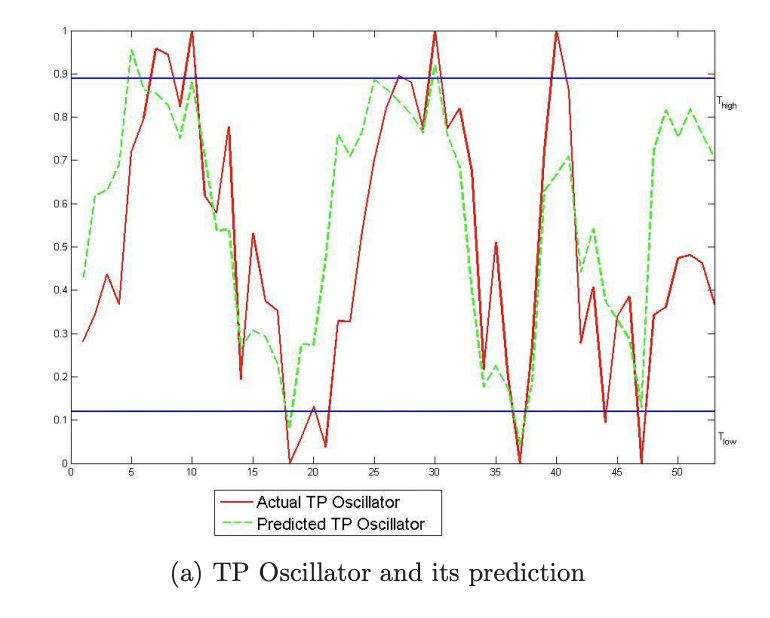

#### Replicating Manuscript Results - Grid Search

Now we will try and use a grid search with our own functions to see if we can optimise our prediction.

In [45]:
extremaFilters = {
    'impact': 0.01
}

testSize = 0.12

valSize = 0.13

gridArgs = {
    'errorFunc': 'TpRMSE'
    , 'paramDict': {
        'C': [2**x for x in range(-10, 10)]
        , 'epsilon': [0.05, 0.1, 0.15]
        , 'gamma': [2**x for x in range(-10, 10)]
        , 'kernel': ['rbf']
    }
    , 'modelString': 'svr'
    , 'Thigh': [x/100 for x in range(0,101)]
    , 'Tlow': [x/100 for x in range (0,101)]
}


# Perform our grid search according to the strategy outlined in the manuscript
gridOutput = TpSVRGridSearch(
    **gridArgs
    , X_train = X_train
    , y_train = y_train
    , X_val = X_val
    , y_val = y_val
)

# Get out a dictionary of the hyperparameters that provided the lowest TpRMSE value
outDf = pd.DataFrame(gridOutput)
optimalRow = outDf[outDf['Errors'] == outDf['Errors'].min()]
bestParams = optimalRow.to_dict(orient = 'records')[0]

In [46]:
[(key, bestParams.get(key)) for key in ['Errors', 'Thigh', 'Tlow', 'C', 'epsilon', 'gamma']]

[('Errors', 0.0018946503057088555),
 ('Thigh', 0.59),
 ('Tlow', 0.58),
 ('C', 0.0009765625),
 ('epsilon', 0.05),
 ('gamma', 0.0009765625)]

In [47]:
onlyParams = bestParams.copy()
[onlyParams.pop(x) for x in ['Errors', 'Thigh', 'Tlow', 'X_train', 'y_train', 'X_val', 'y_val', 'X_test', 'y_test'] if x in onlyParams.keys()]

# Plot our model outputs using these optimal parameters
plotModelOutputs(
    X_train
    , y_train
    , X_test
    , y_val
    , Thigh = bestParams['Thigh']
    , Tlow = bestParams['Tlow']
    , paramDict = onlyParams
    , modelString = 'svr'
)

We see here that, as evidenced in early plots, the optimisation strategy seems to push our hyperparameters to take the smallest possible value in our grid search. Whilst this does minimise our TpRMSE value - as was the intention, this might be quite hopeless as a trading strategy. Obviously some more thought is needed here, but this work is all for fun anyway so lets move on!

Our next steps then are to optimise for the whole point of trading - money. We can do this using the backtrader library  (https://www.backtrader.com/). After playing around with it however, I've taken inspiration from how backtrader works to put together my own copycat classes and functions that have less functionality but run much quicker.

## Testing a Trading Strategy

### Strategy

The strategy we're implementing here is to buy if our predicted value falls below our buy threshold, and sell once our predicted value surpasses our sell threshold. We're only going to trade a single share at a time. All this work gets done in a custom class we've created (tradeStrategy) so we just need to pass it certain bits of data.

### Data Preprocessing

First lets pull the raw data for our train, validation, and test sets. We're going to work with the the same DJIA data.

In [48]:
# Load in DJIA data from October 2008 to May 2009
dataDict = {
    'trainData':
    {
        'data': quandl.get("WIKI/NVDA", start_date=trainingDates[0], end_date=trainingDates[1], api_key= api_key['quandl_key']).reset_index(),
        'dates': trainingDates
    },
    'valData':
    {
        'data': quandl.get("WIKI/NVDA", start_date=valDates[0], end_date=valDates[1], api_key= api_key['quandl_key']).reset_index(),
        'dates': valDates
    },
    'testData':
    {
        'data': quandl.get("WIKI/NVDA", start_date=testDates[0], end_date=testDates[1], api_key= api_key['quandl_key']).reset_index(),
        'dates': testDates
    }
}

dataDict['trainData']['data'].head()

,Date,Open,High,Low,Close,Volume,Ex-Dividend,Split Ratio,Adj. Open,Adj. High,Adj. Low,Adj. Close,Adj. Volume
0,2004-09-08,12.58,12.70,12.29,12.32,6958200.0,0.0,1.0,3.890993,3.928109,3.801296,3.810575,20874600.0
1,2004-09-09,12.62,13.77,12.56,13.55,10827700.0,0.0,1.0,3.903365,4.259060,3.884807,4.191014,32483100.0
2,2004-09-10,13.32,14.14,13.28,14.07,8661200.0,0.0,1.0,4.119875,4.373500,4.107503,4.351849,25983600.0
3,2004-09-13,14.05,14.62,14.03,14.34,8064600.0,0.0,1.0,4.345663,4.521964,4.339477,4.435360,24193800.0
4,2004-09-14,14.21,14.50,14.10,14.40,5696300.0,0.0,1.0,4.395151,4.484848,4.361128,4.453918,17088900.0


Next lets format the data so we have the columns we need and the right index.

In [49]:
# Do some formatting for each dataset
warnings.filterwarnings("ignore", category=FutureWarning) 
for k,v in dataDict.items():

    print(k)
    v['data'] = v['data'][['Date', 'Open', 'High', 'Low', 'Close']]
    v['data'].set_index('Date', inplace = True)
    v['data'] = v['data'].loc[parser.parse(v['dates'][0]):parser.parse(v['dates'][1])]
    print(v['data'].index.min(), v['data'].index.max())

trainData
2004-09-08 00:00:00 2005-11-10 00:00:00
valData
2005-11-11 00:00:00 2006-01-31 00:00:00
testData
2006-02-08 00:00:00 2006-04-26 00:00:00


### Hyperparameter tuning

Now we want to setup our grid for hyperparameter tuning. So let's create a dictionary of the different hyperparameters we want to grid search through. For our custom trading class we also have to create a dictionary that contains information about the commission we want to use in our trading strategy (the % of the value of the trade we'll pay for each trade). A representative commission is something like 0.05% of each trade.

In [50]:
## We're here, we need to update library to deal with different models

In [51]:
# Create a dictionary of all the possible combinations of things we want to optimise through
topParams = {
    'C': [pow(2,x) for x in range(-10,10)]
    , 'epsilon': [0.01, 0.05, 0.1]
}

# Set our commission (percent of trade value we have to pay our broker; e.g. here it is 0.05%
commission = 0.0005

# Specifying here what extrema we are using as our prediction targets, and lookback window size
extremaToGet = {'impact': 0.01}
backtestWindow = 8

We then run the getDataArgs function from our tradingFuncs.py file on our training and validation data. We also have to pass in the impact degree we want to use as targets, our lookback window size, and our grid for searching.

In [52]:
dataArgs = getDataArgs(dataDict['trainData']['data'], dataDict['valData']['data'], extremaToGet, backtestWindow, topParams, commission)
len(dataArgs)

Retrieving only extrema values in impact


60

This function generates a list of dictionaries where each dictionary can be used as an input to the getStratResults function. One dictionary in this list corresponds to one set of hyperparameters, so the length of dataArgs is the same as the total number of combinations of hyperparameters we want to test.

Now we run the getStratResults() function on the output of our getDataArgs function.

The getStratResults function takes one of the dictionaries output by getDataArgs, and creates a tradeStrategy object for every combination of buy and sell thresholds for that set of hyperparameters. It then returns a list of tradeStrategy objects, where the length of the list is equal to the number of different buy/sell threshold combinations attempted.



In [53]:
warnings.filterwarnings("ignore", category=np.VisibleDeprecationWarning) 
output = getStratResults(dataArgs[0])
len(output)

3

If we run getStratResults on all elements in dataArgs, we can generate tradeStrategy objects for all possible combinations of our model hyperparameters, and our buy and sell thresholds. We can then identify which combination give us the greatest returns, and select those parameters for use on our test set.

Here we are going to run getStratResults on every element of dataArgs and do just that.

In [54]:
# Here we are spinning up a wrapper function for getStratResults that lets us print a progressbar whilst we use list comprehension
# to compute its output for every element of dataArgs
def lambdaThis(x, pbar):
    
    pbar.update()
    return getStratResults(x)

with tqdm(range(len(dataArgs)), position = 0, leave = True) as pbar:
    
    megaList = [lambdaThis(x, pbar) for x in dataArgs]
    finalList = list(chain.from_iterable(megaList))

  0%|          | 0/60 [00:00<?, ?it/s]

Now lets get information about every tradeStrategy object we've generated and spin this into a dataframe so we can easily identify the hyperparameters and buy / sell thresholds that led to the greatest returns on our validation dataset.

In [55]:
resultsDfList = list()
for result in finalList:
    
    resultsDfList.append({
        'Thigh': result.metaData['sellPoint']
        , 'Tlow': result.metaData['buyPoint']
        , 'C': result.metaData['C']
        , 'epsilon': result.metaData['epsilon']
        , 'returns': result.stratReturns
        , 'strategyObject': result
    })

resultsDf = pd.DataFrame(resultsDfList)
bestParams = resultsDf[resultsDf['returns'] == np.max(resultsDf['returns'])].iloc[0]

Now lets take a look at the row of our dataframe associated with our best performance.

In [56]:
print(bestParams)

Thigh                                                          0.64
Tlow                                                           0.53
C                                                              16.0
epsilon                                                        0.01
returns                                                        11.6
strategyObject    <tradingFuncs.tradeStrategy object at 0x7f9115...
Name: 3202, dtype: object


## Applying to Test Data

Let's take the parameters from this best performing iteration and use them to see how our strategy performs on test data. We can do this using the evaluateSVRStrat function that takes training data, test data, and other relevant arguments, and returns a tradeStrategy object built using an SVR trained on training data and predicted on test data.

In [57]:
evalArgs = {
    'trainData': dataDict['trainData']['data'].reset_index()
    , 'testData': dataDict['testData']['data']
    , 'extremaFilters': extremaToGet
    , 'lookbackWindow': backtestWindow
    , 'C': bestParams['C']
    , 'epsilon': bestParams['epsilon']
    , 'Thigh': bestParams['Thigh']
    , 'Tlow': bestParams['Tlow']
    , 'commission': commission
}

output = evaluateSVRStrat(**evalArgs)

Retrieving only extrema values in impact


In [58]:
print('Strat value: ', output.getStratValue())
print('BAH value: ', output.getBahValue())

Strat value:  5.36
BAH value:  -15.19


So, we see our strategy beats simply buying and holding a single share over our test period - woo! The real proof of it working however is to test this over multiple test periods and prove this isn't a one off. Time for another notebook..